In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
csv = 'clean_tweet.csv'
my_df = pd.read_csv(csv,index_col=0)
my_df.head()

,text,account_type
0,we have sitting democrat us senator on trial f...,Right
1,marshawn lynch arrives to game in anti trump s...,Right
2,daughter of fallen navy sailor delivers powerf...,Right
3,just in president trump dedicates presidents c...,Right
4,respecting our national anthem standforouranthem,Right


#### Remove null values

In [3]:
my_df[my_df.isnull().any(axis=1)].head()

,text,account_type
6,NaN,Right
135,NaN,Right
146,NaN,Right
149,NaN,Right
163,NaN,Right


In [4]:
my_df.dropna(inplace=True)
my_df.reset_index(drop=True,inplace=True)
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202315 entries, 0 to 202314
Data columns (total 2 columns):
text            202315 non-null object
account_type    202315 non-null object
dtypes: object(2)
memory usage: 3.1+ MB


In [5]:
np.sum(my_df.isnull().any(axis=1))

0

#### Basic wordcloud for data

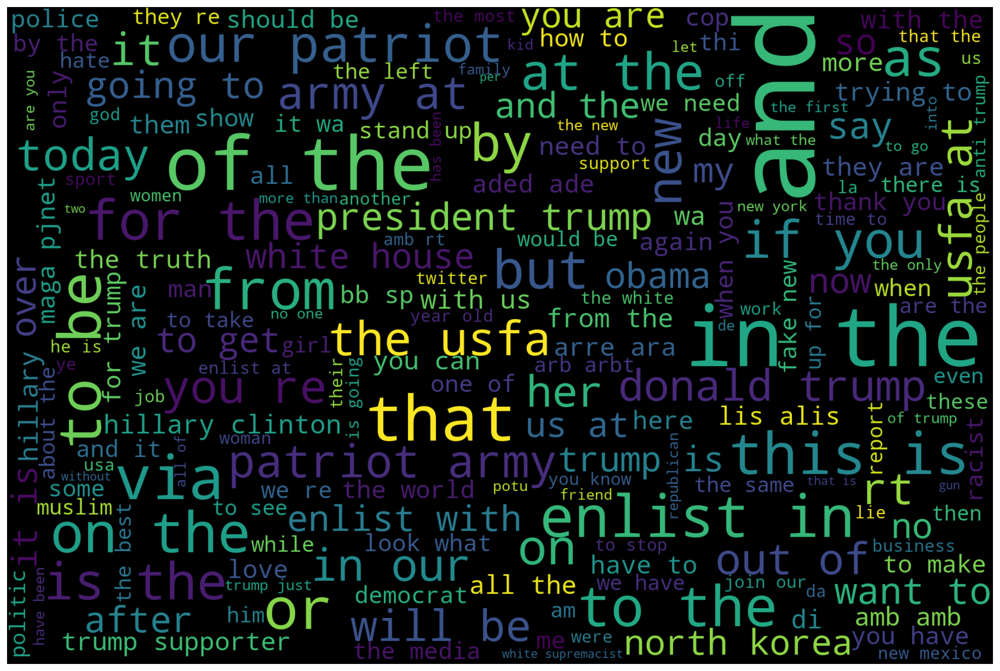

In [21]:
all_tweets = my_df
all_string = []
for t in all_tweets.text:
    all_string.append(t)
all_string = pd.Series(all_string).str.cat(sep=' ')
from wordcloud import WordCloud
stopping=["do","not"]
wordcloud = WordCloud(stopwords=stopping, width=1800, height=1200,max_font_size=200).generate(all_string)
plt.figure(figsize=(18,12))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

#### Tokenize

In [9]:
from nltk.tokenize import word_tokenize
tokenized_word=word_tokenize(all_string)
print(tokenized_word)

['we', 'have', 'sitting', 'democrat', 'us', 'senator', 'on', 'trial', 'for', 'corruption', 'and', 'you', 've', 'barely', 'heard', 'peep', 'from', 'the', 'mainstream', 'media', 'marshawn', 'lynch', 'arrives', 'to', 'game', 'in', 'anti', 'trump', 'shirt', 'judging', 'by', 'his', 'sagging', 'pants', 'the', 'shirt', 'should', 'say', 'lynch', 'vs', 'belt', 'daughter', 'of', 'fallen', 'navy', 'sailor', 'delivers', 'powerful', 'monologue', 'on', 'anthem', 'protests', 'burns', 'her', 'nfl', 'packers', 'gear', 'boycottnfl', 'just', 'in', 'president', 'trump', 'dedicates', 'presidents', 'cup', 'golf', 'tournament', 'trophy', 'to', 'the', 'people', 'of', 'florida', 'texas', 'and', 'puerto', 'rico', 'respecting', 'our', 'national', 'anthem', 'standforouranthem', 'dan', 'bongino', 'nobody', 'trolls', 'liberals', 'better', 'than', 'donald', 'trump', 'exactly', 'does', 'not', 'matter', 'that', 'cnn', 'does', 'not', 'report', 'on', 'your', 'crimes', 'this', 'will', 'not', 'change', 'the', 'fact', 'tha

In [10]:
from nltk.probability import FreqDist
fdist = FreqDist(tokenized_word)
print(fdist)

<FreqDist with 94523 samples and 2390524 outcomes>


In [11]:
fdist.most_common(20)

[('the', 68543),
 ('to', 54854),
 ('in', 35917),
 ('of', 32858),
 ('is', 28573),
 ('for', 25249),
 ('and', 25195),
 ('trump', 22615),
 ('you', 21953),
 ('not', 21073),
 ('rt', 20153),
 ('on', 18961),
 ('it', 17144),
 ('at', 14113),
 ('this', 13553),
 ('that', 13160),
 ('with', 13117),
 ('are', 11839),
 ('we', 10112),
 ('be', 10106)]

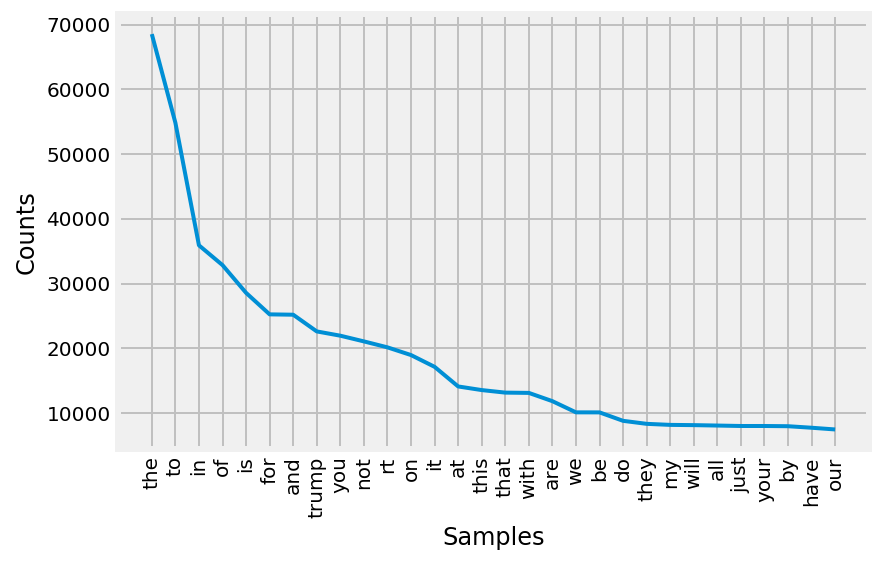

In [12]:
# Frequency Distribution Plot
import matplotlib.pyplot as plt
fdist.plot(30,cumulative=False)
plt.show()

#### Remove Stopwords

In [13]:
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')
stop_words=set(stopwords.words("english"))
print(stop_words)

{'after', 'as', 'no', 'the', 'with', 'mustn', "mightn't", 'my', 'up', 'them', "isn't", 'shouldn', 'not', 'mightn', 'some', 'only', 'hadn', 'on', 'didn', "it's", 'won', "you'd", 'if', 'their', 'she', 'needn', 'itself', 'been', 'll', 'under', 'doing', 'too', 'has', 'few', 'can', 'your', "don't", 'for', "doesn't", 'hasn', 'that', 'other', "didn't", 't', 'isn', 'while', 'were', 'be', 'how', 'most', 'an', 'these', 'you', 'him', 'theirs', 'each', 'over', 'o', 'in', 'than', 'am', "should've", 'haven', 'yourself', 'himself', 'such', 'don', 'it', "you're", "won't", 'whom', 'why', "mustn't", 'do', 'we', 'to', "wouldn't", 'very', 'ain', 'should', 've', 'but', 'below', 'against', 'who', 'then', "shan't", 'so', 'before', "couldn't", "hasn't", 'being', 'where', 'further', 'at', 're', 'out', 'both', 's', 'doesn', 'yourselves', 'shan', 'now', 'because', 'weren', 'themselves', 'a', "wasn't", 'are', 'ourselves', 'once', 'y', 'having', "haven't", "she's", 'again', 'by', 'd', 'nor', 'herself', 'which', 'a

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/computer/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [14]:
filtered_sent=[]
for w in tokenized_word:
    if w not in stop_words:
        filtered_sent.append(w)
#print("Tokenized Sentence:",tokenized_word)
print("Filterd Sentence:",filtered_sent)

Filterd Sentence: ['sitting', 'democrat', 'us', 'senator', 'trial', 'corruption', 'barely', 'heard', 'peep', 'mainstream', 'media', 'marshawn', 'lynch', 'arrives', 'game', 'anti', 'trump', 'shirt', 'judging', 'sagging', 'pants', 'shirt', 'say', 'lynch', 'vs', 'belt', 'daughter', 'fallen', 'navy', 'sailor', 'delivers', 'powerful', 'monologue', 'anthem', 'protests', 'burns', 'nfl', 'packers', 'gear', 'boycottnfl', 'president', 'trump', 'dedicates', 'presidents', 'cup', 'golf', 'tournament', 'trophy', 'people', 'florida', 'texas', 'puerto', 'rico', 'respecting', 'national', 'anthem', 'standforouranthem', 'dan', 'bongino', 'nobody', 'trolls', 'liberals', 'better', 'donald', 'trump', 'exactly', 'matter', 'cnn', 'report', 'crimes', 'change', 'fact', 'going', 'much', 'hate', 'promoting', 'cnn', 'article', 'admitting', 'everything', 'trump', 'said', 'pr', 'relief', 'two', 'days', 'ago', 'genocide', 'remark', 'san', 'juan', 'mayor', 'narrative', 'changed', 'though', 'fixes', 'reporting', 'const

In [15]:
from nltk.probability import FreqDist
fdist = FreqDist(filtered_sent)
print(fdist)

<FreqDist with 94380 samples and 1630925 outcomes>


In [16]:
fdist.most_common(20)

[('trump', 22615),
 ('rt', 20153),
 ('new', 6115),
 ('people', 5932),
 ('obama', 5595),
 ('us', 5483),
 ('like', 5201),
 ('hillary', 5165),
 ('news', 5060),
 ('get', 4991),
 ('breaking', 4885),
 ('enlist', 4746),
 ('one', 4604),
 ('video', 4530),
 ('police', 3862),
 ('president', 3821),
 ('america', 3819),
 ('via', 3729),
 ('white', 3538),
 ('maga', 3483)]

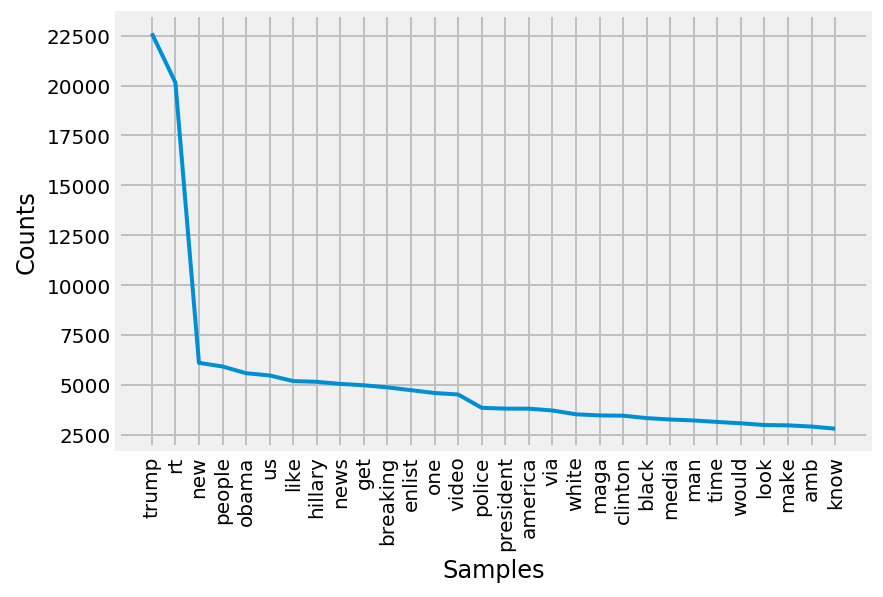

<Figure size 1728x7200 with 0 Axes>

In [34]:
# Frequency Distribution Plot
import matplotlib.pyplot as plt
fdist.plot(30,cumulative=False)
plt.show()

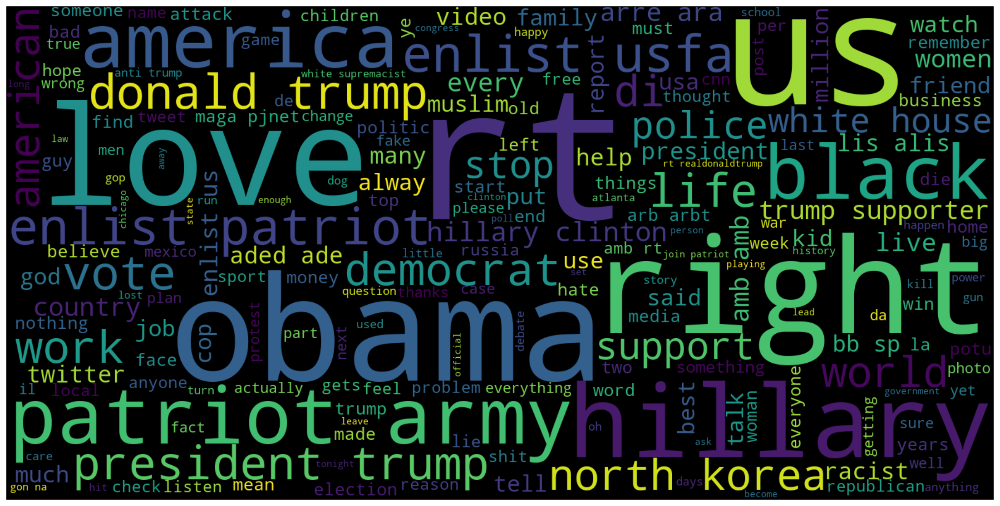

In [46]:
from wordcloud import STOPWORDS
filt_sent = " ".join(filtered_sent)
stopping=["do","not","need","like","make","one","via","would","want","today","see","think","go","get",
         "man","take","know","say","new","let","thank","back","come","call","may","says","good","going",
         "really","way","still","another","got","day","news","could","year","got","even","keep","show",
         "people","thing","great","better","without","never","first","real", "girl","give", "never","first",
         "time"] + list(STOPWORDS)
wordcloud = WordCloud(stopwords=stopping, width=1600, height=800,max_font_size=300).generate(filt_sent)
plt.figure(figsize=(24,10))
plt.imshow(wordcloud, interpolation="bilinear")
#plt.imshow(wordcloud)
plt.axis("off")
plt.show()

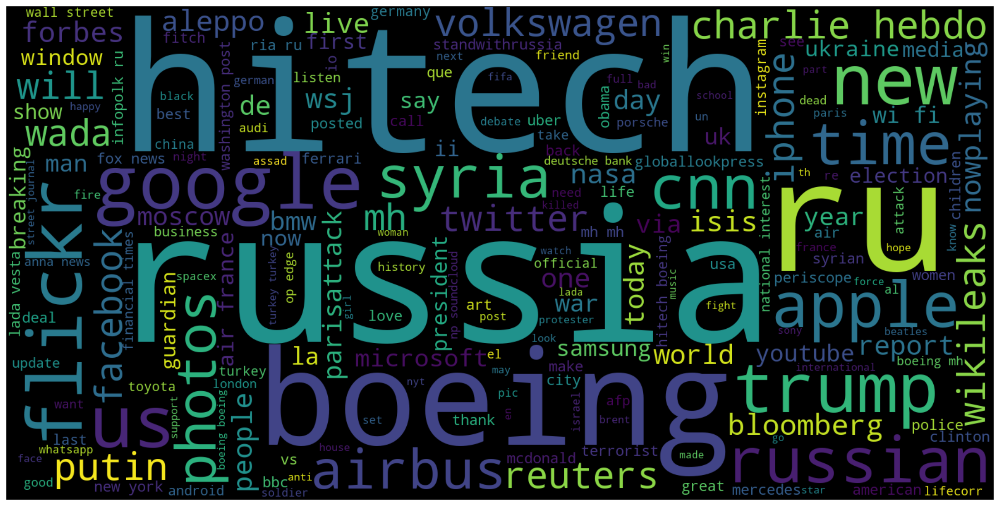

In [47]:
from wordcloud import STOPWORDS
rus_tweets = my_df[my_df.account_type == "Russian"]
rus_string = []
for t in rus_tweets.text:
    rus_string.append(t)
rus_string = pd.Series(rus_string).str.cat(sep=' ')
from wordcloud import WordCloud
stop_words = ["https", "co", "RT","ap","photo","video"] + list(STOPWORDS)
wordcloud = WordCloud(stopwords=stop_words, width=1600, height=800,max_font_size=300).generate(rus_string)
plt.figure(figsize=(24,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

(-0.5, 1599.5, 799.5, -0.5)

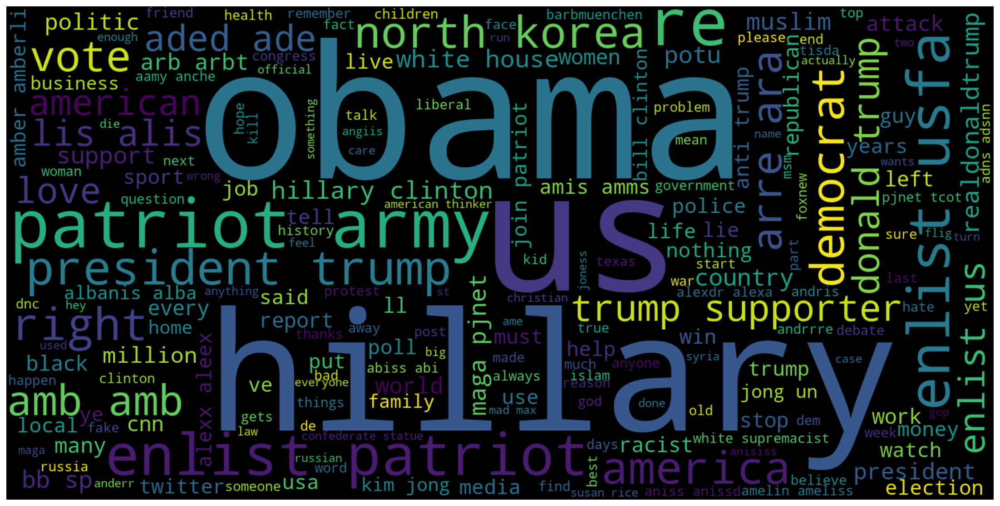

In [50]:
from wordcloud import STOPWORDS
right_tweets = my_df[my_df.account_type == "Right"]
right_string = []
for t in right_tweets.text:
    right_string.append(t)
right_string = pd.Series(right_string).str.cat(sep=' ')
from wordcloud import WordCloud
stop_words = ["https", "co", "RT","ap","photo","video","do","not","need","like","make","one","via","would","want","today","see","think","go","get",
         "man","take","know","say","new","let","thank","back","come","call","may","says","good","going",
         "really","way","still","another","got","day","news","could","year","got","even","keep","show",
         "people","thing","great","better","without","never","first","real", "girl","give", "never","first",
         "time","now","will"] + list(STOPWORDS)
wordcloud = WordCloud(stopwords=stop_words, width=1600, height=800,max_font_size=300).generate(right_string)
plt.figure(figsize=(24,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")

(-0.5, 1599.5, 799.5, -0.5)

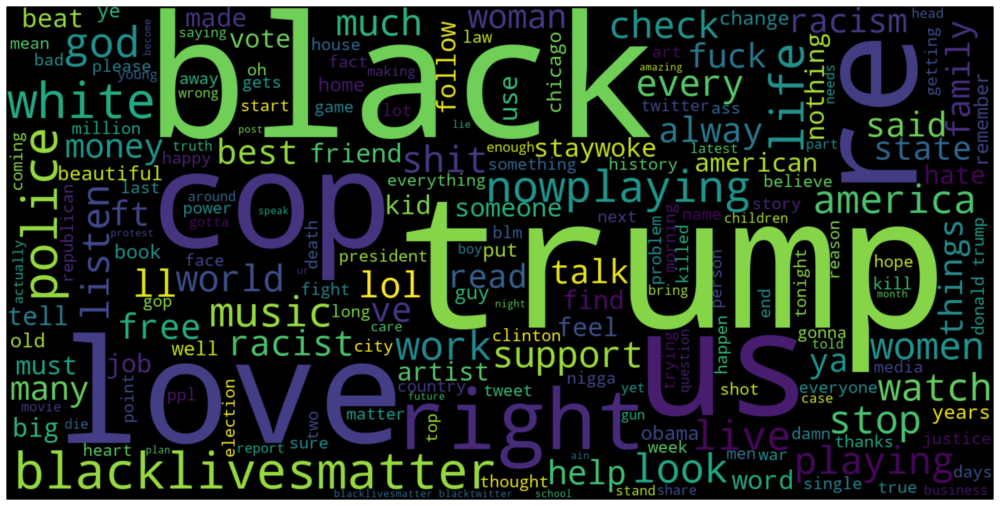

In [51]:
from wordcloud import STOPWORDS
left_tweets = my_df[my_df.account_type == "Left"]
left_string = []
for t in left_tweets.text:
    left_string.append(t)
left_string = pd.Series(left_string).str.cat(sep=' ')
from wordcloud import WordCloud
stop_words = ["https", "co", "RT","ap","photo","video","do","not","need","like","make","one","via","would","want","today","see","think","go","get",
         "man","take","know","say","new","let","thank","back","come","call","may","says","good","going",
         "really","way","still","another","got","day","news","could","year","got","even","keep","show",
         "people","thing","great","better","without","never","first","real", "girl","give", "never","first",
         "time","now","will"] + list(STOPWORDS)
wordcloud = WordCloud(stopwords=stop_words, width=1600, height=800,max_font_size=300).generate(left_string)
plt.figure(figsize=(24,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")